<h2><p style="text-align: center;">Sprint 3</p></h2>

---

## Project 3: `Flight Price Prediction`

**Group 6:**   
Hamna Ashraf - 8826836\
John Prasad - 8976716\
Simardeep Singh - 8976948

### **Required Libraries**

In [243]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping

## **Data Loading**

In [244]:
df = pd.read_csv('E:\Conestoga\Term 2\AI for business\Sprint 3\data\Clean_dataset.csv')
df.head()

,Unnamed: 0,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955


## **Data Cleaning and Preprocessing**

### Checking missing values

In [245]:
print(df.isnull().sum())

Unnamed: 0          0
airline             0
flight              0
source_city         0
departure_time      0
stops               0
arrival_time        0
destination_city    0
class               0
duration            0
days_left           0
price               0
dtype: int64


First we need to remove the irrelevant features

In [246]:
df = df.drop(['Unnamed: 0', 'flight'],axis=1)

In [247]:
print(df.describe())

            duration      days_left          price
count  300153.000000  300153.000000  300153.000000
mean       12.221021      26.004751   20889.660523
std         7.191997      13.561004   22697.767366
min         0.830000       1.000000    1105.000000
25%         6.830000      15.000000    4783.000000
50%        11.250000      26.000000    7425.000000
75%        16.170000      38.000000   42521.000000
max        49.830000      49.000000  123071.000000


## **Univariate Analysis**

### Histogram of prices

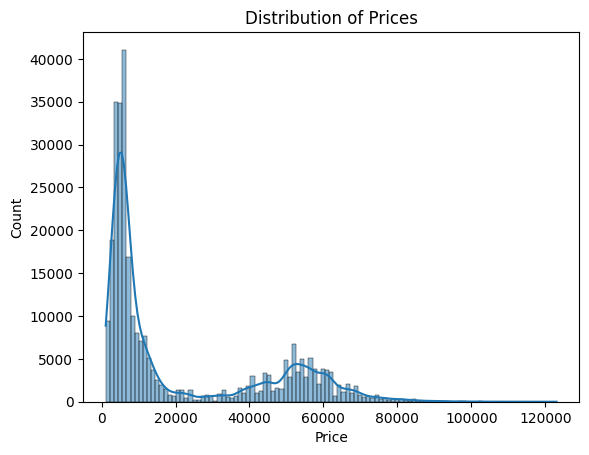

In [248]:
sns.histplot(df['price'], kde=True)
plt.title('Distribution of Prices')
plt.xlabel('Price')
plt.show()

It appears that there are more flights priced between 20,000 and 40,000 than any other price range. There are also a significant number of flights priced between 0 and 20,000 and between 40,000 and 80,000. There are very few flights priced above 80,000.

###  Boxplot to check for outliers in another numeric field like duration

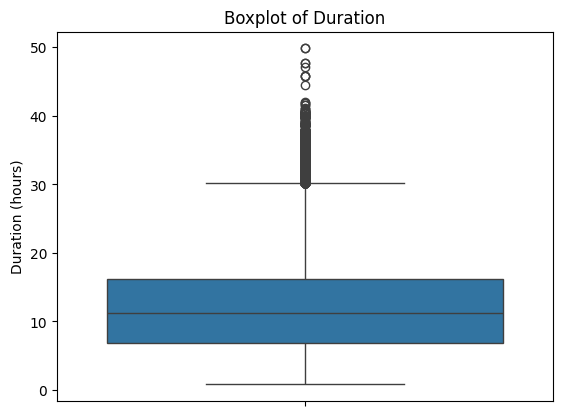

In [249]:
sns.boxplot(y=df['duration'])
plt.title('Boxplot of Duration')
plt.ylabel('Duration (hours)')
plt.show()

The majority of the durations fall between approximately 10 and 20.
The median duration is around 20, indicating that half of the data points have durations lower than 20 and the other half have durations higher

## **Bivariate Analysis**

###  Price vs Airline

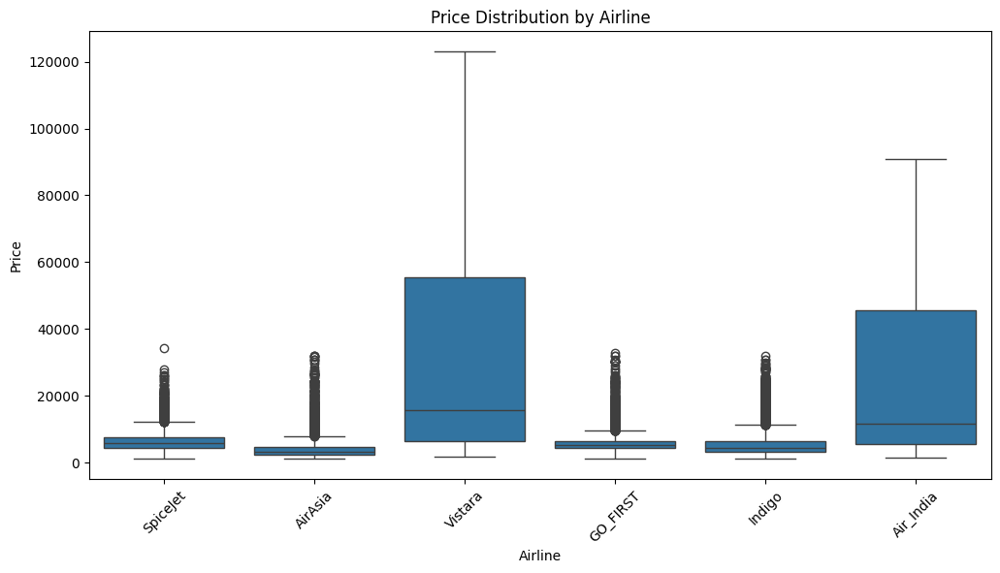

In [250]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='airline', y='price', data=df)
plt.xticks(rotation=45)
plt.title('Price Distribution by Airline')
plt.xlabel('Airline')
plt.ylabel('Price')
plt.show()


SpiceJet appears to be the cheapest airline, with a price range around 20,000.
AirAsia appears to be a bit more expensive than SpiceJet, with a price range around 40,000.
Vistara, GO_FIRST, Indigo and Air India appear to be the most expensive airlines, all priced around 60,000

###  Scatter plot of price vs days_left

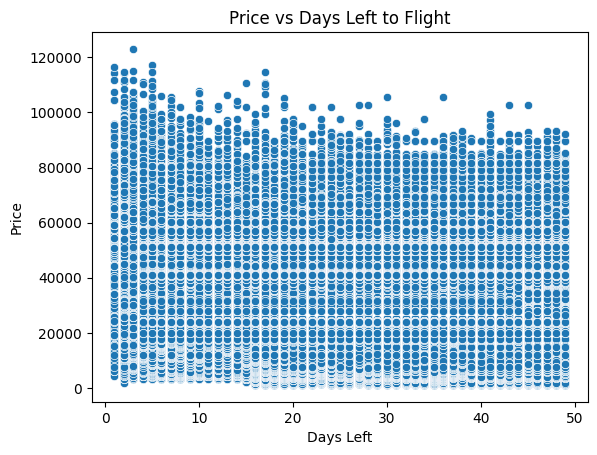

In [251]:
sns.scatterplot(x='days_left', y='price', data=df)
plt.title('Price vs Days Left to Flight')
plt.xlabel('Days Left')
plt.ylabel('Price')
plt.show()

There is a general upward trend in the graph, which means that flights tend to be more expensive as the departure date approaches. There is also a significant amount of scatter in the data, which means that there is a lot of variability in prices even for flights with the same number of days left to departure.


Some possible reasons for the variability in prices:

Time of year: Flights tend to be more expensive during peak travel seasons.
Day of the week: Flights tend to be more expensive on weekends and holidays.
Demand: Flights tend to be more expensive when there is more demand for seats on a particular route.
Airline: Different airlines may charge different prices for the same route.

## **Multivariate Analysis**

### Price by both class and source city

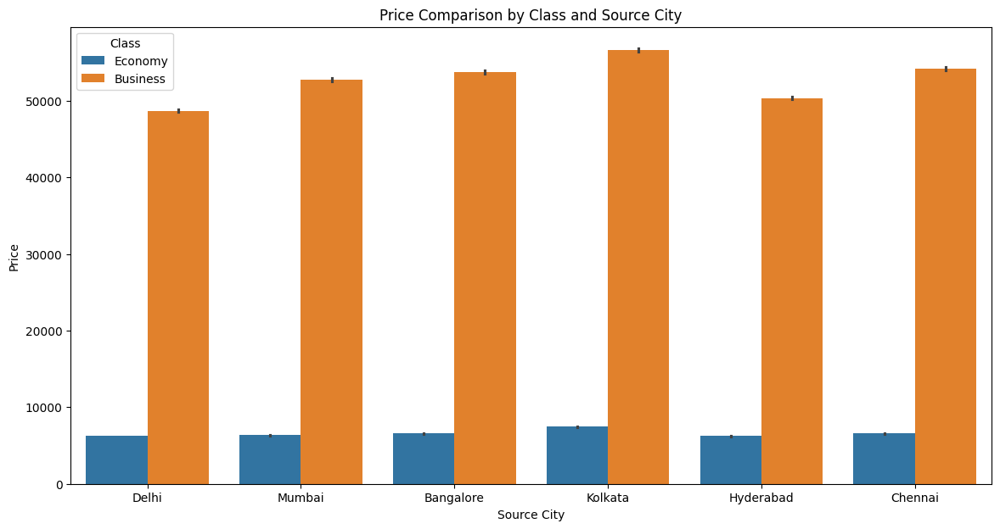

In [252]:
plt.figure(figsize=(14, 7))
sns.barplot(x='source_city', y='price', hue='class', data=df)
plt.title('Price Comparison by Class and Source City')
plt.xlabel('Source City')
plt.ylabel('Price')
plt.legend(title='Class')
plt.show()

The Economy Class is generally lower than the line for Business Class across all the cities. This means that Economy Class flights are cheaper than Business Class flights on all routes. Flights from Delhi appear to be the cheapest, with both Economy and Business Class flights costing less than flights from other cities. Flights from Kolkata appear to be the most expensive, with both Economy and Business Class flights costing more than flights from other cities.

## **Correlation matrix**

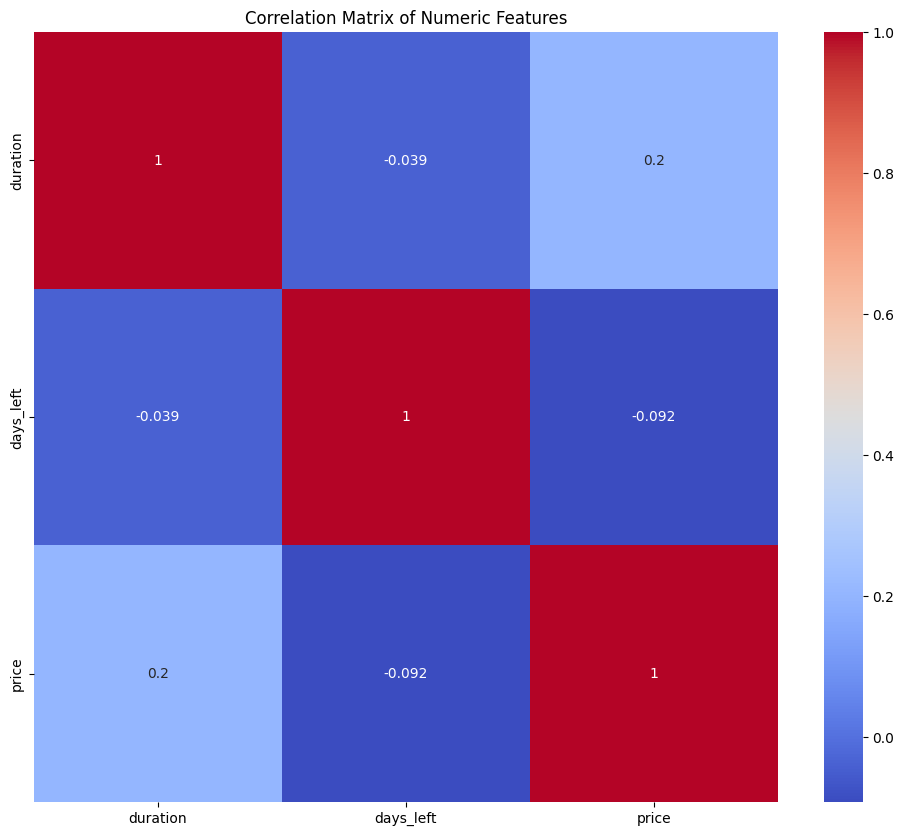

In [253]:

# Exclude non-numeric 
numeric_df = df.select_dtypes(include=[np.number])

#correlation matrix
corr_matrix = numeric_df.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Numeric Features')
plt.show()


A positive correlation coefficient between two variables "duration" and "price," suggests that as the duration increases, the price also tends to increase. Conversely, a negative correlation coefficient indicates an inverse relationship, implying that as one variable increases, the other tends to decrease.

This is the co-relation between features that had number values. \
To see the co-relation for all features, we need to perform encoding.

Based on the unique values for each column, we will see which encoding to use

In [254]:
for col in df.columns:
  count_values = df[col].value_counts()
  print(f'\033[35m{col}\033[0m has {len(count_values)} unique values')

airline has 6 unique values
source_city has 6 unique values
departure_time has 6 unique values
stops has 3 unique values
arrival_time has 6 unique values
destination_city has 6 unique values
class has 2 unique values
duration has 476 unique values
days_left has 49 unique values
price has 12157 unique values


In [255]:
df['class'] = df['class'].map({'Business': 1, 'Economy': 0})

**One-hot encoding:**

In [256]:
df['stops'] = df['stops'].apply(lambda x: 0 if x=='zero' else 1 if x=='one' else 2)

2 means '2 or more' stops

In [278]:
df.head()

,airline,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,Delhi,Evening,0,Night,Mumbai,0,2.17,1,5953
1,SpiceJet,Delhi,Early_Morning,0,Morning,Mumbai,0,2.33,1,5953
2,AirAsia,Delhi,Early_Morning,0,Early_Morning,Mumbai,0,2.17,1,5956
3,Vistara,Delhi,Morning,0,Afternoon,Mumbai,0,2.25,1,5955
4,Vistara,Delhi,Morning,0,Morning,Mumbai,0,2.33,1,5955


In [258]:
encoded_df = pd.get_dummies(df, columns=['airline', 'source_city', 'departure_time', 'arrival_time', 'destination_city'])

In [259]:
encoded_df.head()

,stops,class,duration,days_left,price,airline_AirAsia,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara,source_city_Bangalore,source_city_Chennai,source_city_Delhi,source_city_Hyderabad,source_city_Kolkata,source_city_Mumbai,departure_time_Afternoon,departure_time_Early_Morning,departure_time_Evening,departure_time_Late_Night,departure_time_Morning,departure_time_Night,arrival_time_Afternoon,arrival_time_Early_Morning,arrival_time_Evening,arrival_time_Late_Night,arrival_time_Morning,arrival_time_Night,destination_city_Bangalore,destination_city_Chennai,destination_city_Delhi,destination_city_Hyderabad,destination_city_Kolkata,destination_city_Mumbai
0,0,0,2.17,1,5953,False,False,False,False,True,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True
1,0,0,2.33,1,5953,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
2,0,0,2.17,1,5956,True,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True
3,0,0,2.25,1,5955,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,True
4,0,0,2.33,1,5955,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,True


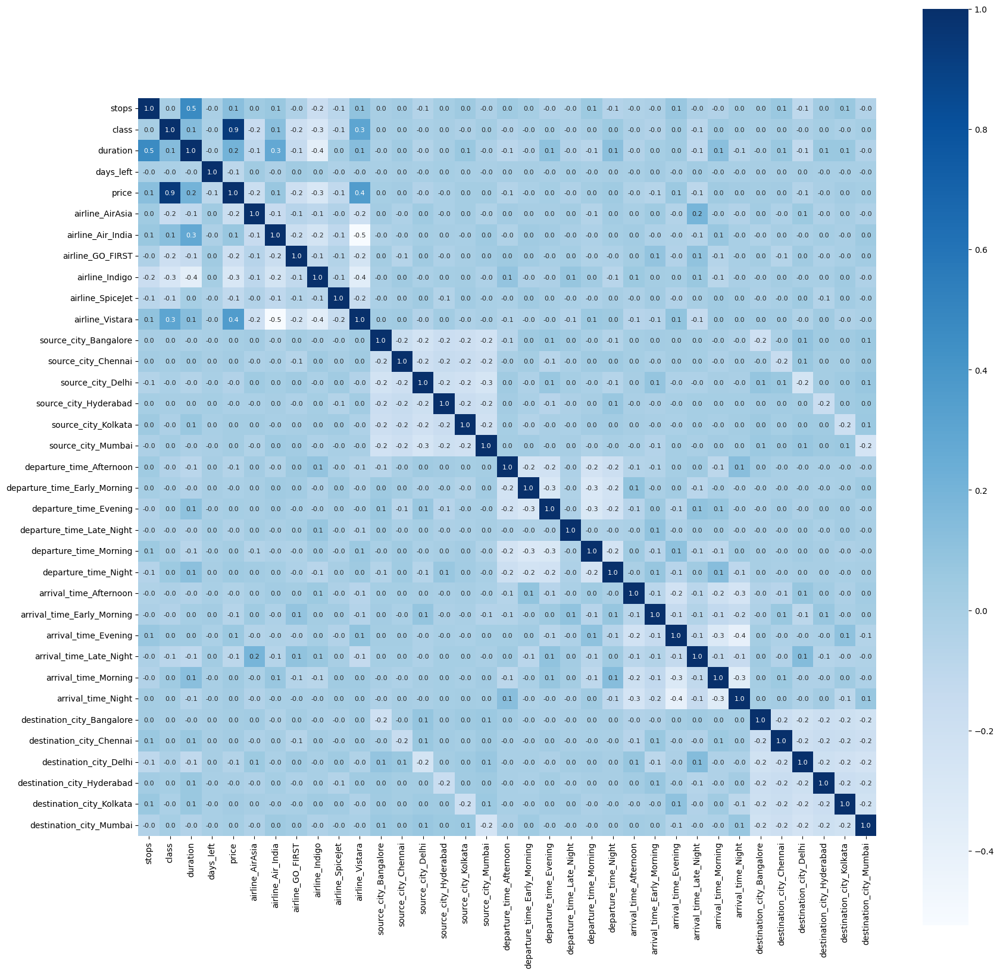

In [260]:
correlation = encoded_df.corr()
plt.figure(figsize=(20,20))
sns.heatmap(correlation, cbar=True,square=True,fmt='.1f',annot=True,annot_kws={'size':8},cmap="Blues")
plt.show()

The correlation matrix reveals relationships between flight features. Strong positive correlations exist between features like duration and days left to departure (flights get longer with more days till departure).

There is a very strong co-relation between the feature 'class' and 'price'. If value of class changes from 0 to 1 (i.e Economy to Business), there is a sudden increase in price.

In [261]:
columns = ['airline','source_city','departure_time','stops','arrival_time','destination_city','class']

for col in columns:
    count_values = df[col].value_counts().reset_index()
    count_values.columns = [col, 'count']
    fig = px.pie(count_values, names=col, values='count', title=f'Distribution of {col}')
    fig.update_layout(width=600, height=500)  

    fig.show()

## Model Selection and training:

Before we train the model, we need to normalize the data first

In [262]:
numerical_features = ['duration', 'days_left']
scaler = StandardScaler()
normalized_numerical = scaler.fit_transform(encoded_df[numerical_features])

normalized_df = pd.DataFrame(normalized_numerical, columns=numerical_features)
dataset = pd.concat([normalized_df, encoded_df.drop(columns=numerical_features)], axis=1)
dataset = dataset.sample(frac=1, random_state=42).reset_index(drop=True)

For this problem we will be considering two models to work with:
- Linear Regression
- Random Forest 

Based in the model accuracy we will see which model will work best for us

In [263]:
x = dataset.drop(['price'], axis = 1)
Y = dataset['price']

In [264]:
x_train, x_test, y_train, y_test = train_test_split(x, Y, test_size = 0.2, random_state = 42)

In [265]:
pd.set_option('display.max_columns', None)
dataset.head()

,duration,days_left,stops,class,price,airline_AirAsia,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara,source_city_Bangalore,source_city_Chennai,source_city_Delhi,source_city_Hyderabad,source_city_Kolkata,source_city_Mumbai,departure_time_Afternoon,departure_time_Early_Morning,departure_time_Evening,departure_time_Late_Night,departure_time_Morning,departure_time_Night,arrival_time_Afternoon,arrival_time_Early_Morning,arrival_time_Evening,arrival_time_Late_Night,arrival_time_Morning,arrival_time_Night,destination_city_Bangalore,destination_city_Chennai,destination_city_Delhi,destination_city_Hyderabad,destination_city_Kolkata,destination_city_Mumbai
0,1.046857,1.032023,1,0,7366,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,True,False
1,-0.332456,1.179505,1,1,64831,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,True
2,-0.239297,1.105764,1,0,6195,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,True,True,False,False,False,False,False
3,0.316878,-0.885242,1,1,60160,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False,False,False
4,-0.552145,-0.442796,1,0,6578,False,True,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True


### Linear Regression:

In [266]:
def predict_evaluate_model(model):
# Model score
    train_score = model.score(x_train, y_train)
    test_score = model.score(x_test, y_test)
    print(f'Train score {train_score}, Test score {test_score}')

    # Make model predict on train and test data
    y_train_pred = model.predict(x_train)
    y_test_pred = model.predict(x_test)

    train_mae = mean_absolute_error(y_train, y_train_pred)
    test_mae = mean_absolute_error(y_test, y_test_pred)

    train_mse = mean_squared_error(y_train, y_train_pred)
    test_mse = mean_squared_error(y_test, y_test_pred)

    train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
    test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))

    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)

    print(f'Train MAE: {train_mae}, Test MAE: {test_mae}')
    print(f'Train MSE: {train_mse}, Test MSE: {test_mse}')
    print(f'Train RMSE: {train_rmse}, Test RMSE: {test_rmse}')
    print(f'Train R^2: {train_r2}, Test R^2: {test_r2}')

    return y_train_pred, y_test_pred

In [267]:
m1 = LinearRegression()
m1.fit(x_train, y_train)

y_train_pred, y_test_pred = predict_evaluate_model(m1)

Train score 0.9100985105028954, Test score 0.9095013069183244
Train MAE: 4517.518809188662, Test MAE: 4532.2608485615765
Train MSE: 46232522.40149903, Test MSE: 46960062.39540404
Train RMSE: 6799.450154350647, Test RMSE: 6852.741232193438
Train R^2: 0.9100985105028954, Test R^2: 0.9095013069183244


**R^2** approximately 91% suggests that the model fits data well and generalizes well to unseen data.\
**Train and Test Scores** are very close to one another which means that model is not overfitting.\
**Prediction Error** is between 4500 which means that the prediction can be wrong around Rs. 4500 - 6800 as found by MAE and RMSE

**Plot for Predictions vs Actual Values - Train and Test**

In [268]:
def plot_graph():
    fig = make_subplots(rows=1, cols=2, subplot_titles=("Training Set", "Test Set"))

    # Scatter plot for training actual vs training predicted without hover info
    fig.add_trace(go.Scattergl(
        x=y_train, y=y_train_pred,
        mode='markers',
        name='Train Data',
        marker=dict(color='blue', size=5, symbol='circle'),
        hoverinfo='skip' 
    ), row=1, col=1)

    fig.add_trace(go.Scattergl(
        x=[min(y_train), max(y_train)],
        y=[min(y_train), max(y_train)],
        mode='lines',
        name='Prediction',
        line=dict(color='black', dash='dot'),
        hoverinfo='skip'  
    ), row=1, col=1)

    fig.add_trace(go.Scattergl(
        x=y_test, y=y_test_pred,
        mode='markers',
        name='Test Data',
        marker=dict(color='red', size=5, symbol='circle'),
        hoverinfo='skip'  
    ), row=1, col=2)

    fig.add_trace(go.Scattergl(
        x=[min(y_test), max(y_test)],
        y=[min(y_test), max(y_test)],
        mode='lines',
        name='Prediction',
        line=dict(color='black', dash='dash'),
        hoverinfo='skip' 
    ), row=1, col=2)

    fig.update_layout(
        title="Model Predictions vs Actual Values",
        width=1200,
        height=500
    )

    fig.update_xaxes(title_text="Actual Values (Train)", row=1, col=1)
    fig.update_yaxes(title_text="Predicted Values (Train)", row=1, col=1)
    fig.update_xaxes(title_text="Actual Values (Test)", row=1, col=2)
    fig.update_yaxes(title_text="Predicted Values (Test)", row=1, col=2)

    fig.show()

In [269]:
plot_graph()

### Random Forest:

In [270]:
m2 = RandomForestRegressor(n_jobs=-1)
m2.fit(x_train, y_train)

y_train_pred, y_test_pred = predict_evaluate_model(m2)

Train score 0.9974994383957352, Test score 0.9854344623433801
Train MAE: 420.6008442305506, Test MAE: 1064.1656799503999
Train MSE: 1285932.758535926, Test MSE: 7558104.254170459
Train RMSE: 1133.9897523945822, Test RMSE: 2749.2006573130416
Train R^2: 0.9974994383957352, Test R^2: 0.9854344623433801


This models has performed a lot better than the linear regression model.\
**R^2** value equal to 98-99% on both train and test data shows that model gives a good fit.\
**Prediction error:** From MSE and RMSE, we can see that the prediction can wrong by Rs. 1000-2700 on unseen data

Plotting the prediction:

In [271]:
plot_graph()

The plot shows a good regression line for train and test predictions.

**Dummy prediction**

In [277]:
#Flight from Chennai to Hyderabad
input_data = {
    'duration': [10.4],  
    'days_left': [48], 
    'stops': [1],  
    'class': [1],  
    'airline_AirAsia': [0],
    'airline_Air_India': [0],
    'airline_GO_FIRST': [0],
    'airline_Indigo': [0],
    'airline_SpiceJet': [0],
    'airline_Vistara': [1],
    'source_city_Bangalore': [0],
    'source_city_Chennai': [1],
    'source_city_Delhi': [0],
    'source_city_Hyderabad': [0],
    'source_city_Kolkata': [0],
    'source_city_Mumbai': [0],
    'departure_time_Afternoon': [1],
    'departure_time_Early_Morning': [0],
    'departure_time_Evening': [0],
    'departure_time_Late_Night': [0],
    'departure_time_Morning': [0],
    'departure_time_Night': [0],
    'arrival_time_Afternoon': [0],
    'arrival_time_Early_Morning': [0],
    'arrival_time_Evening': [0],
    'arrival_time_Late_Night': [0],
    'arrival_time_Morning': [0],
    'arrival_time_Night': [1],
    'destination_city_Bangalore': [0],
    'destination_city_Chennai': [0],
    'destination_city_Delhi': [0],
    'destination_city_Hyderabad': [1],
    'destination_city_Kolkata': [0],
    'destination_city_Mumbai': [0]
}

input_df = pd.DataFrame(input_data)

# Make the prediction
predicted_price = m2.predict(input_df)
print(f'Predicted Price: Rs.{round(predicted_price[0], 2)}')

Predicted Price: Rs.57905.35


**Conclusion:**

We found that random forest model which we used for regression problem, worked better than linear regression model and gave an R^2 value equal to 0.98 on test data, which means that the model explains high proportion of variation on unseen data.

References:\
https://www.kaggle.com/code/eslammohamed100/flight-price-prediction
